# Make figure 6 of the paper
References: 
- https://www.pygmt.org/v0.2.0/gallery/plot/meca.html

In [1]:
import pandas as pd
import pygmt 
from pyproj import Transformer
import matplotlib.pyplot as plt
from obspy.core.event import read_events

import numpy as np
import matplotlib.colors as mcolors
from matplotlib import cm



In [2]:
df = pd.read_csv('../data/datasets_all_regions/origin_2010_2015_reloc_cog_morton_ver3.csv',index_col=0)
df


,lat,lon,depth,time,orid,nass,p_picks,s_picks,rms,nsphz,gap,algorithm,id_Morton,dist,dt,NonDimDist
0,47.22533,-122.16895,56.111,1.262305e+09,0,7,2,5,1.081,5.0,235.831208,genie,0,0.753784,4.933721e+07,411143.414481
1,48.19518,-121.77276,3.820,1.262305e+09,1,55,25,30,0.985,30.0,201.698107,genie,0,1.333054,4.933712e+07,411142.646872
2,47.86208,-122.09903,17.799,1.262330e+09,2,28,10,18,0.784,18.0,181.023074,genie,0,0.957326,4.931184e+07,410932.027590
3,47.96435,-122.91906,21.286,1.262336e+09,3,20,10,10,0.465,10.0,150.528010,genie,0,0.684951,4.930621e+07,410885.088574
4,45.87262,-122.19180,9.822,1.262362e+09,4,39,20,19,0.657,19.0,237.324295,genie,0,1.627692,4.927976e+07,410664.693011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63882,40.59439,-124.42438,19.741,1.435097e+09,63882,23,9,14,1.015,14.0,73.959960,genie,4408,0.112501,7.919735e+03,65.997794
63883,40.54636,-127.10076,26.165,1.435100e+09,63883,12,1,11,0.744,11.0,223.080984,genie,4408,2.139193,9.995899e+03,83.299204
63884,49.74167,-124.58578,5.274,1.435101e+09,63884,13,7,6,0.894,6.0,197.904075,genie,4408,9.188393,1.107364e+04,92.281049
63885,40.64363,-125.36531,1.891,1.435101e+09,63885,8,3,5,0.982,5.0,145.748415,genie,4408,0.824720,1.158579e+04,96.548245


In [3]:
_df = df[(df.rms < 2.5) & (df.p_picks > 4) & (df.s_picks > 4)].sort_values('nass', ascending=True)
_df

,lat,lon,depth,time,orid,nass,p_picks,s_picks,rms,nsphz,gap,algorithm,id_Morton,dist,dt,NonDimDist
92,40.39017,-124.26529,21.344,1.262785e+09,92,10,5,5,0.139,5.0,248.688402,genie,1,3.898960,4.885739e+07,407144.938225
188,40.58319,-124.74977,20.747,1.263089e+09,188,10,5,5,0.229,5.0,325.567758,genie,1,3.718278,4.855300e+07,404608.294751
190,40.56413,-124.71725,17.893,1.263089e+09,190,10,5,5,0.289,5.0,324.367216,genie,1,3.735384,4.855287e+07,404607.257479
191,40.65043,-124.63284,18.936,1.263089e+09,191,10,5,5,0.173,5.0,321.243107,genie,1,3.645034,4.855268e+07,404605.625998
194,40.51176,-124.64650,15.746,1.263090e+09,194,10,5,5,0.417,5.0,321.393995,genie,1,3.784074,4.855221e+07,404601.789071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46632,48.17382,-122.70349,52.237,1.401017e+09,46632,146,72,74,1.274,74.0,104.764319,genie,1880,3.007186,1.121952e+05,934.959815
22644,43.42639,-127.20676,9.676,1.340113e+09,22644,147,110,37,1.420,37.0,208.863738,genie,306,5.891495,6.026427e+03,50.220782
18656,48.74665,-128.13167,44.739,1.328386e+09,18656,152,102,50,1.296,50.0,193.110739,genie,155,5.226390,6.954134e+03,57.951495
20177,48.32102,-122.30360,10.816,1.332624e+09,20177,166,96,70,1.738,70.0,148.662855,genie,207,4.215390,1.466634e+04,122.219600


## Entire Region

/tmp/ipykernel_1327816/4064612463.py:31: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
/tmp/ipykernel_1327816/4064612463.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


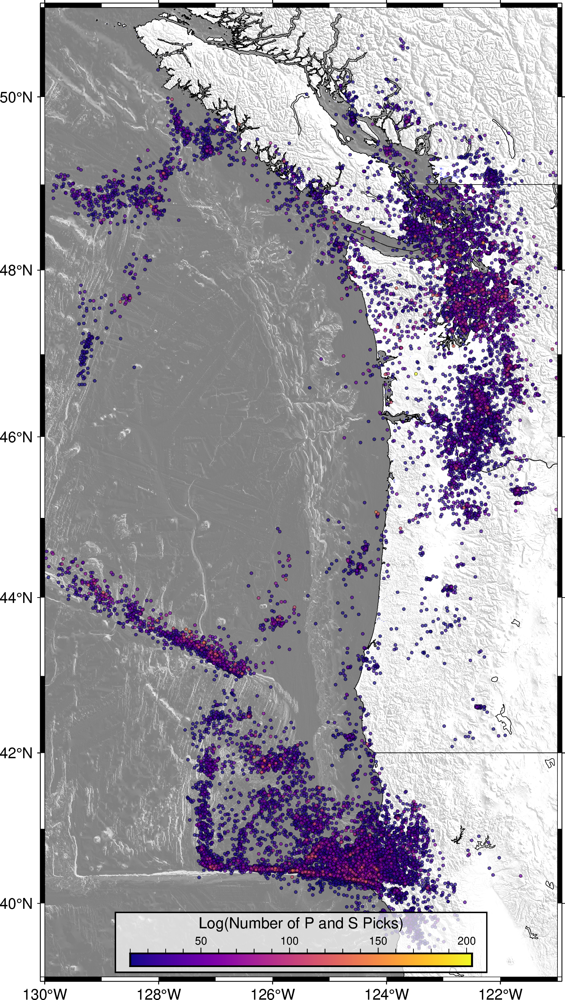

In [47]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 39
max_lat = 51
min_lon = -130
max_lon = -121

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot a dummy point to add the station legend
fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.07c",
    color=_df["nass"] ,  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=30
)

# Add title text
fig.colorbar(
    position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
    box="+gwhite@30+p0.8p,black",
    frame=["x+lLog(Number of P and S Picks)"],
)
# Save the figure
fig.savefig("../data/datasets_all_regions/all_catalog_events_2010_2015_ver3_nass_log.pdf")

# Display the figure
fig.show()


## Plot with the focal mechanisms

In [4]:
usgs_cat = read_events('../data/datasets_all_regions/Cascadia_momenttensors_M5_9.xml')

In [5]:
longitude = []
latitude = []
depth = []
strike = []
dip = []
rake = []
magnitudes = []

for event in usgs_cat:
    try:
        lon = event.origins[1].longitude
        lat = event.origins[1].latitude
        z = event.origins[1].depth / 1000  # Convert depth to km
        for i in range(len(event.focal_mechanisms)):
            if event.focal_mechanisms[i].nodal_planes:
                nodal_plane = event.focal_mechanisms[i].nodal_planes.nodal_plane_1
                continue
            if not event.focal_mechanisms[i].nodal_planes:
                continue
        mag = event.preferred_magnitude()['mag']
        sdr = [nodal_plane.strike, nodal_plane.dip, nodal_plane.rake]
        longitude.append(lon)
        latitude.append(lat)
        depth.append(z)
        strike.append(sdr[0])
        dip.append(sdr[1])
        rake.append(sdr[2])
        magnitudes.append(mag)

    except (IndexError, AttributeError) as e:
        print(f"Skipping event due to missing data: {e}")

df = pd.DataFrame({'lon': longitude, 'lat': latitude, 'strike': strike, 'dip': dip, 'rake': rake,'depth': depth,'mag':magnitudes})


In [6]:
len(usgs_cat)

18

In [7]:
df

,lon,lat,strike,dip,rake,depth,mag
0,-124.6067,40.3180,90.0,80.0,-150.0,17.17,5.72
1,-125.1338,40.8287,200.0,85.0,130.0,16.64,6.80
2,-121.0600,40.1920,105.0,85.0,-140.0,9.70,5.69
3,-128.5420,49.1390,220.0,85.0,5.0,10.00,6.10
4,-127.5370,43.5230,300.0,89.0,-175.0,10.00,5.80
5,-123.7900,41.1430,5.0,40.0,-100.0,28.20,5.60
6,-127.0810,49.3960,350.0,85.0,-165.0,17.30,6.40
7,-127.2400,43.5800,26.0,80.0,-1.0,10.00,5.00
8,-129.3500,49.3300,233.0,42.0,-10.0,10.00,5.30
9,-125.8200,43.7600,19.0,70.0,-17.0,10.00,5.20


In [17]:
df['mag'] = 5.5

In [43]:
# # %matplotlib widget
# lon = []
# lat = []
# strike = []
# dip = []
# rake = []
# magnitude = []
# depth = []
# for c in usgs_cat:
#     lon.append(c.origins[0].longitude)
#     lat.append(c.origins[0].latitude)
    
#     nodalplane = c.focal_mechanisms[1].nodal_planes.nodal_plane_1
#     sdr = [nodalplane.strike,nodalplane.dip,nodalplane.rake]
#     mag = c.preferred_magnitude().mag
#     depth = c.origins[0].depth / 1000.0  # Convert depth from meters to kilometers
#     magnitude.append(mag)
#     strike.append(sdr[0])
#     dip.append(sdr[1])
#     rake.append(sdr[2])

# df = pd.DataFrame({'lon': lon, 'lat': lat, 'strike': strike, 'dip': dip, 'rake': rake, 'mag': mag, 'depth': depth})
# # Plot the data

/tmp/ipykernel_1854480/3640136182.py:31: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
/tmp/ipykernel_1854480/3640136182.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


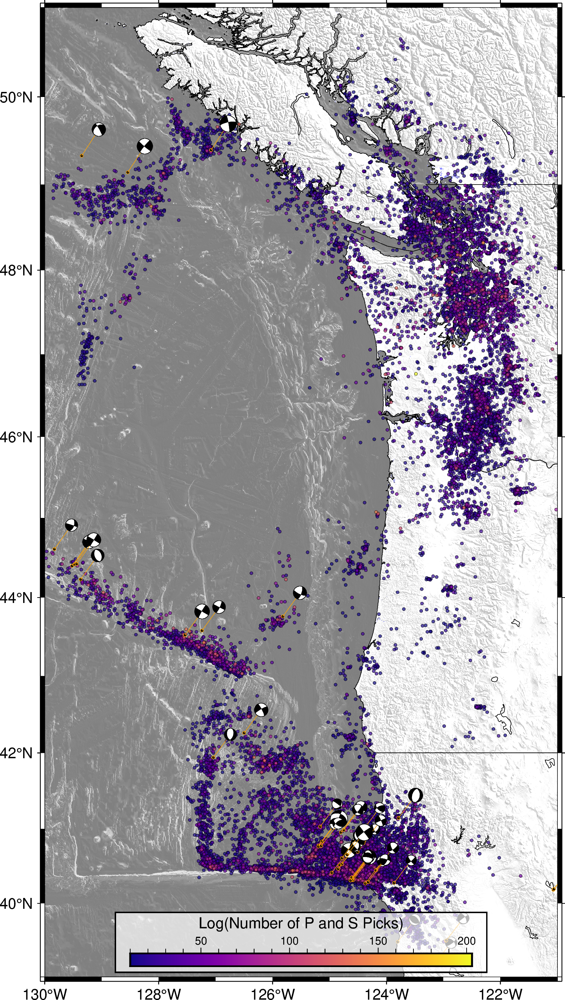

In [261]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 39
max_lat = 51
min_lon = -130
max_lon = -121

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot a dummy point to add the station legend
fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.07c",
    color=_df["nass"] ,  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=30
)

focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,orange+s0.07c")

# Add title text
fig.colorbar(
    position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
    box="+gwhite@30+p0.8p,black",
    frame=["x+lLog(Number of P and S Picks)"],
)
# Save the figure
fig.savefig("../data/datasets_all_regions/all_catalog_events_2010_2015_ver3_nass_fo_m4.png")

# Display the figure
fig.show()


## Axial and Endeavor


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1854480/586112668.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1854480/586112668.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


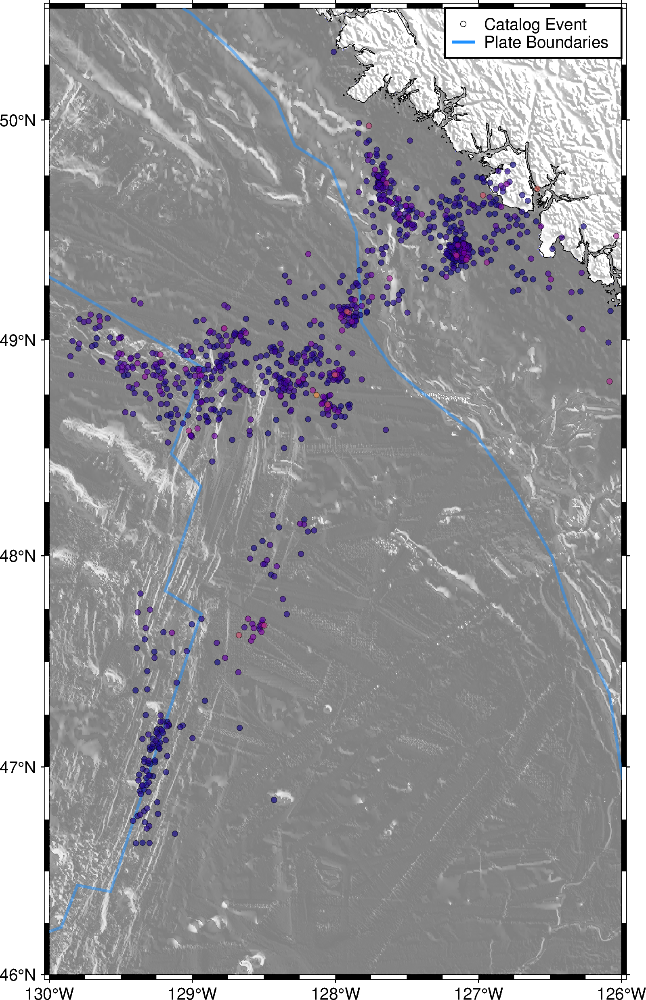

In [266]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50.5
min_lon = -130
max_lon = -126

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(a)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
# fig.text(
#     x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
#     y=max_lat - (max_lat - min_lat) * (1 / 28),  # Adjust y based on 1.5 cm from top
#     text=title,
#     font="25p,Helvetica-Bold,black",
#     no_clip=True
# )

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/axial_endeavor_events_2010_2015_ver3_nass.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_2327881/1511427222.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_2327881/1511427222.py:45: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


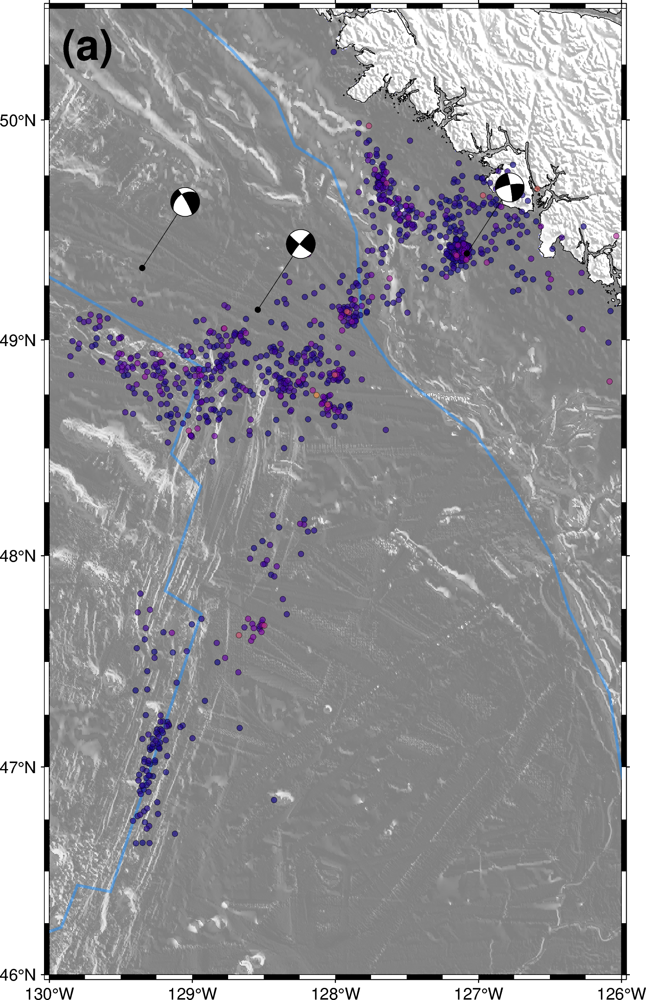

In [26]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50.5
min_lon = -130
max_lon = -126

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(a)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
fig.text(
    x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
    y=max_lat - (max_lat - min_lat) * (1 / 28),  # Adjust y based on 1.5 cm from top
    text=title,
    font="25p,Helvetica-Bold,black",
    no_clip=True
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )
focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.55c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,black+s0.12c")
# Add the legend to the plot
# fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/axial_endeavor_events_2010_2015_ver3_nass_fo_4_no_legend.png")

# Display the figure
fig.show()


## Mendicino


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1327816/34552171.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1327816/34552171.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


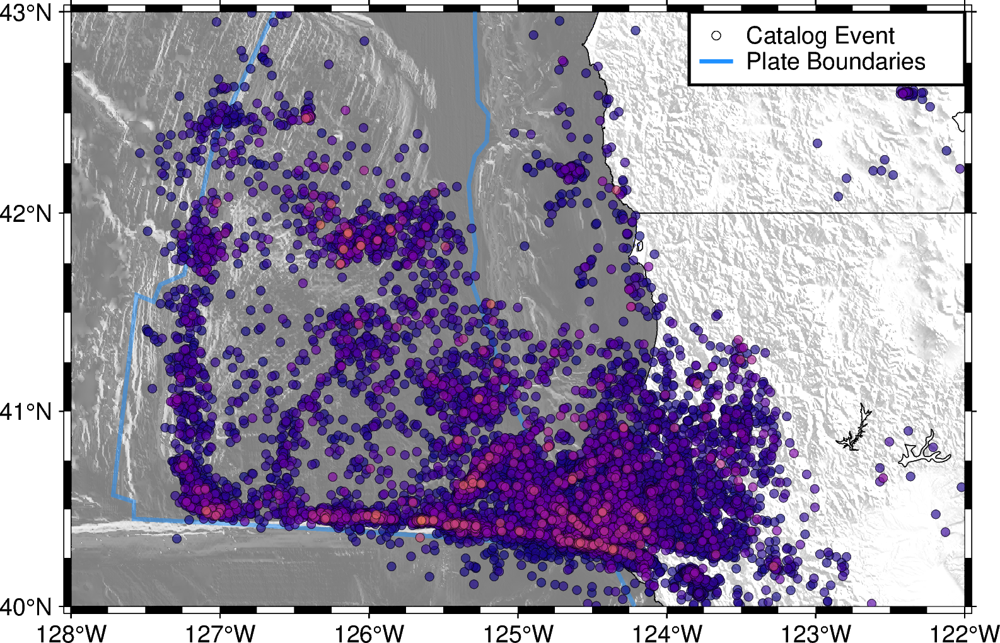

In [53]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 43
min_lon = -128
max_lon = -122

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(b)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
# fig.text(
#     x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
#     y=max_lat - (max_lat - min_lat) * (1 / 13),  # Adjust y based on 1.5 cm from top
#     text=title,
#     font="25p,Helvetica-Bold,black",
#     no_clip=True
# )

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/mendocino_events_2010_2015_ver3_nass_no_relief_no_label.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_2327881/165517513.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_2327881/165517513.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


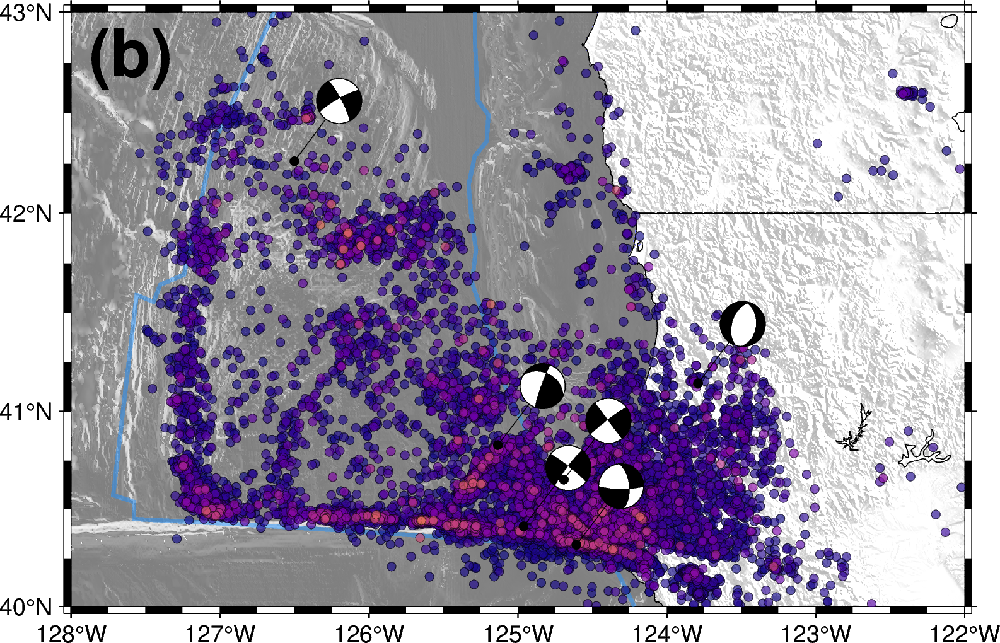

In [27]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 43
min_lon = -128
max_lon = -122

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(b)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
# Position the text 1.5 cm from the top left corner
fig.text(
    x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
    y=max_lat - (max_lat - min_lat) * (1 / 15),  # Adjust y based on 1.5 cm from top
    text=title,
    font="25p,Helvetica-Bold,black",
    no_clip=True
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )
focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.55c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,black+s0.12c")
# Add the legend to the plot
# fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/mendocino_events_2010_2015_ver3_nass_fo_4_no_legend.png")

# Display the figure
fig.show()


## A zoomed-in view of the junction

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1327816/3420424612.py:37: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1327816/3420424612.py:47: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")
text [WARNING]: Skipped 1 records as blank - please check input data.


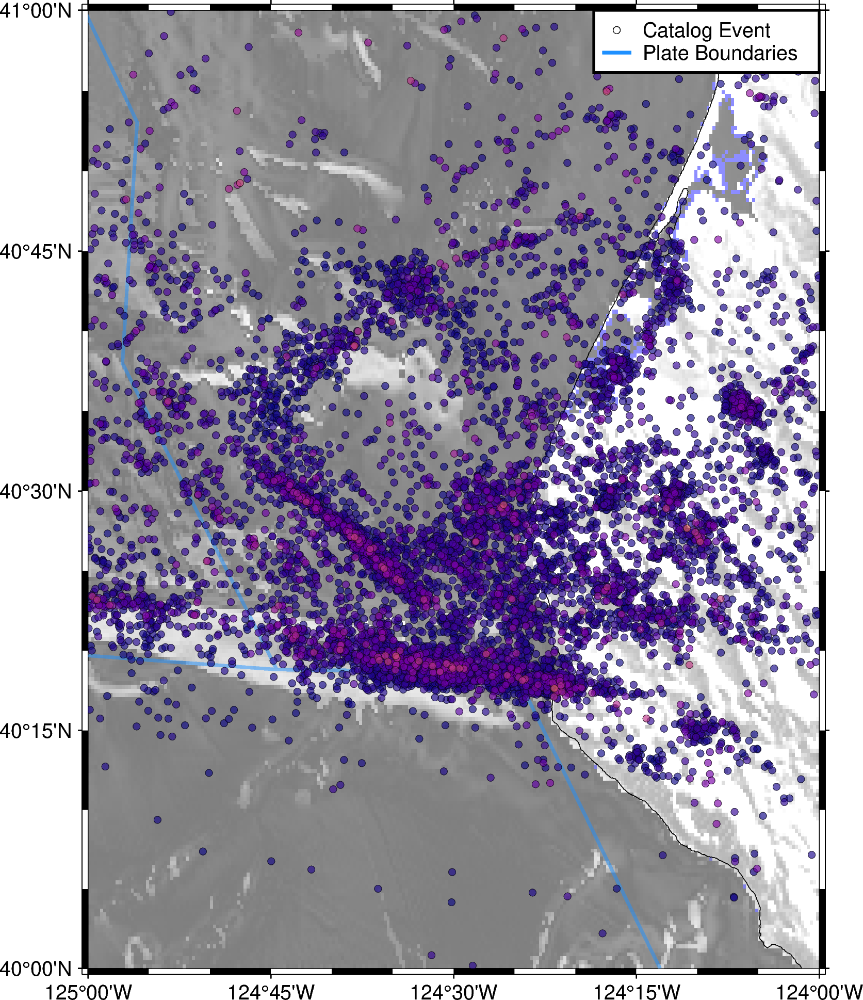

In [55]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 41
min_lon = -125
max_lon = -124


# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = ""

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

fig.text(
    x=-125.25, y=40.36, text=title,
    font="25p,Helvetica-Bold,black",
    no_clip=True    # This prevents the text from being clipped
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/mendocino_events_zoomed_in_2010_2015_ver3_nass_no_relief.png")

# Display the figure
fig.show()


## Around 44.5N


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_2180962/2477350180.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_2180962/2477350180.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


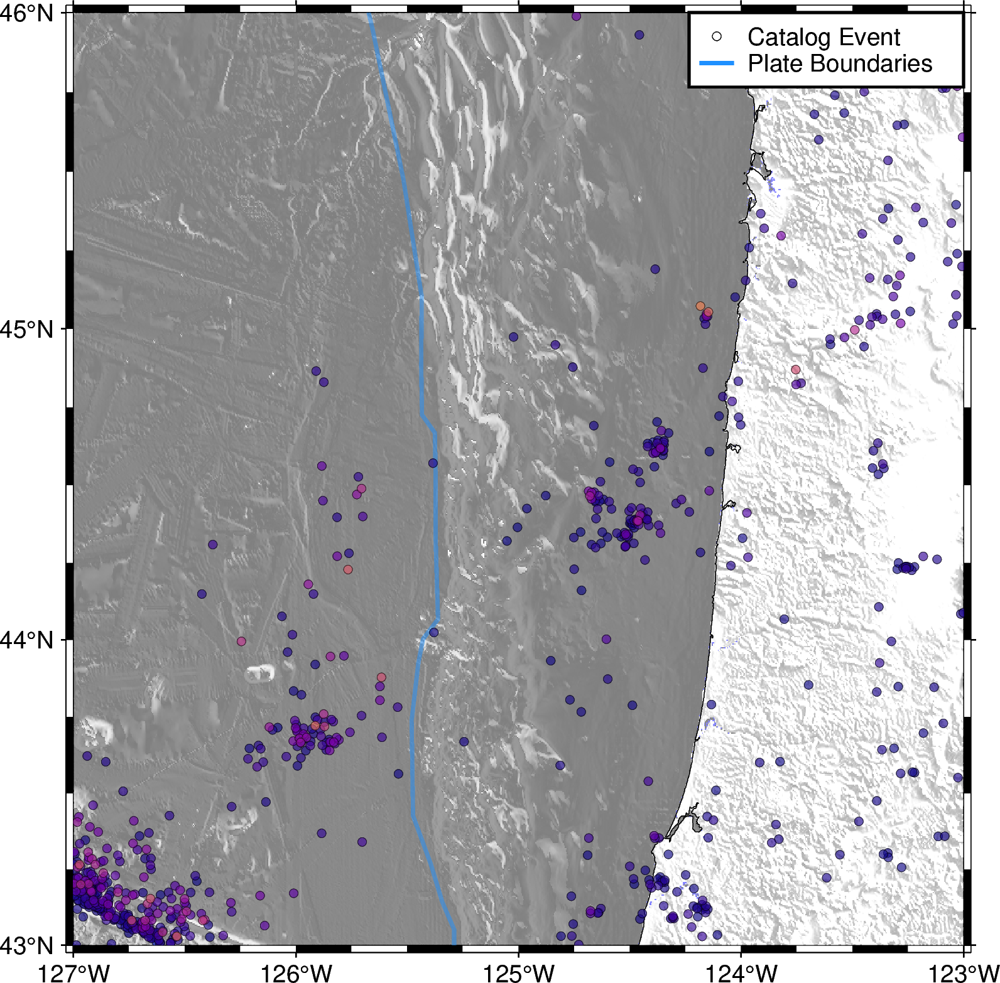

In [19]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 43
max_lat = 46
min_lon = -127
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(c)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
# fig.text(
#     x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
#     y=max_lat - (max_lat - min_lat) * (1 / 19),  # Adjust y based on 1.5 cm from top
#     text=title,
#     font="25p,Helvetica-Bold,black",
#     no_clip=True
# )

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/around_445_events_2010_2015_ver3_nass_no_relief_no_label.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_2327881/1231583936.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_2327881/1231583936.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


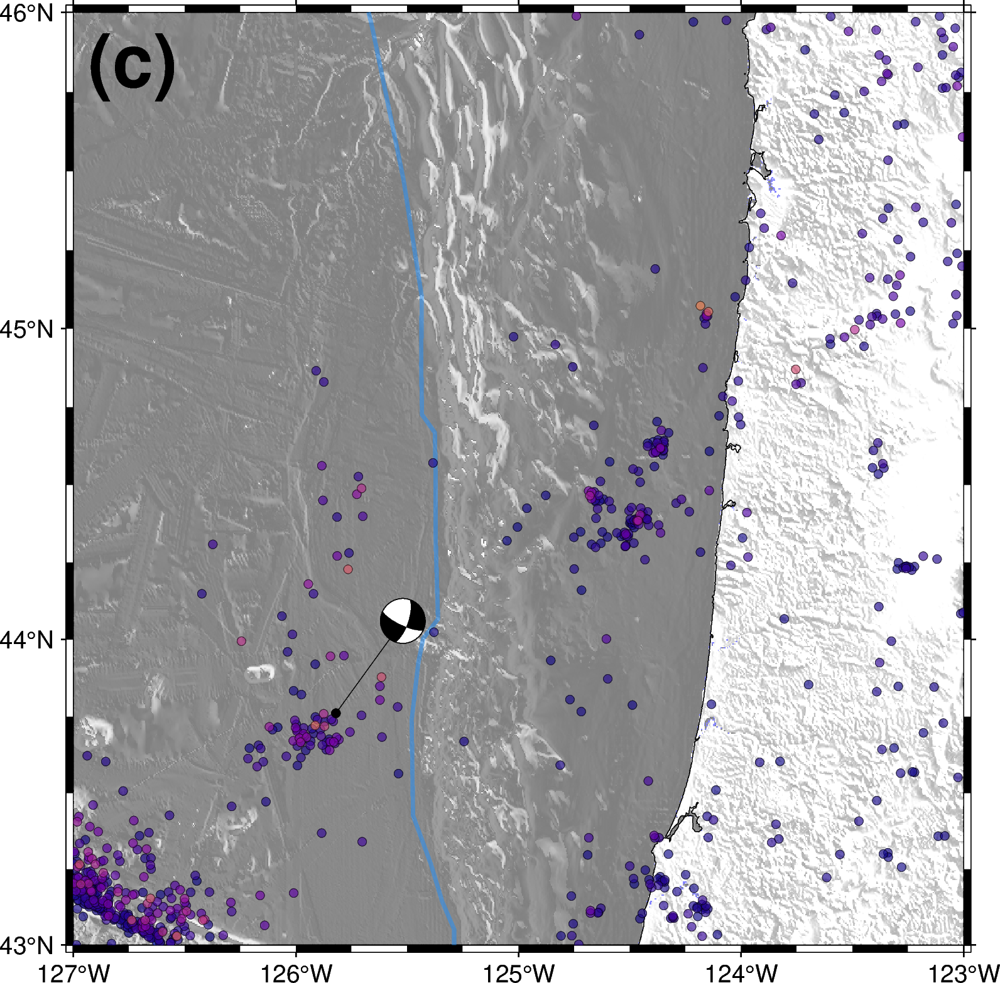

In [28]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 43
max_lat = 46
min_lon = -127
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(c)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
## Position the text 1.5 cm from the top left corner
fig.text(
    x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
    y=max_lat - (max_lat - min_lat) * (1 / 20),  # Adjust y based on 1.5 cm from top
    text=title,
    font="28p,Helvetica-Bold,black",
    no_clip=True
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )
focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.55c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,black+s0.12c")
# Add the legend to the plot
# fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/around_445_events_2010_2015_ver3_nass_fo_4_no_legend.png")

# Display the figure
fig.show()


## Northern WA

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1327816/2599283827.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1327816/2599283827.py:44: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


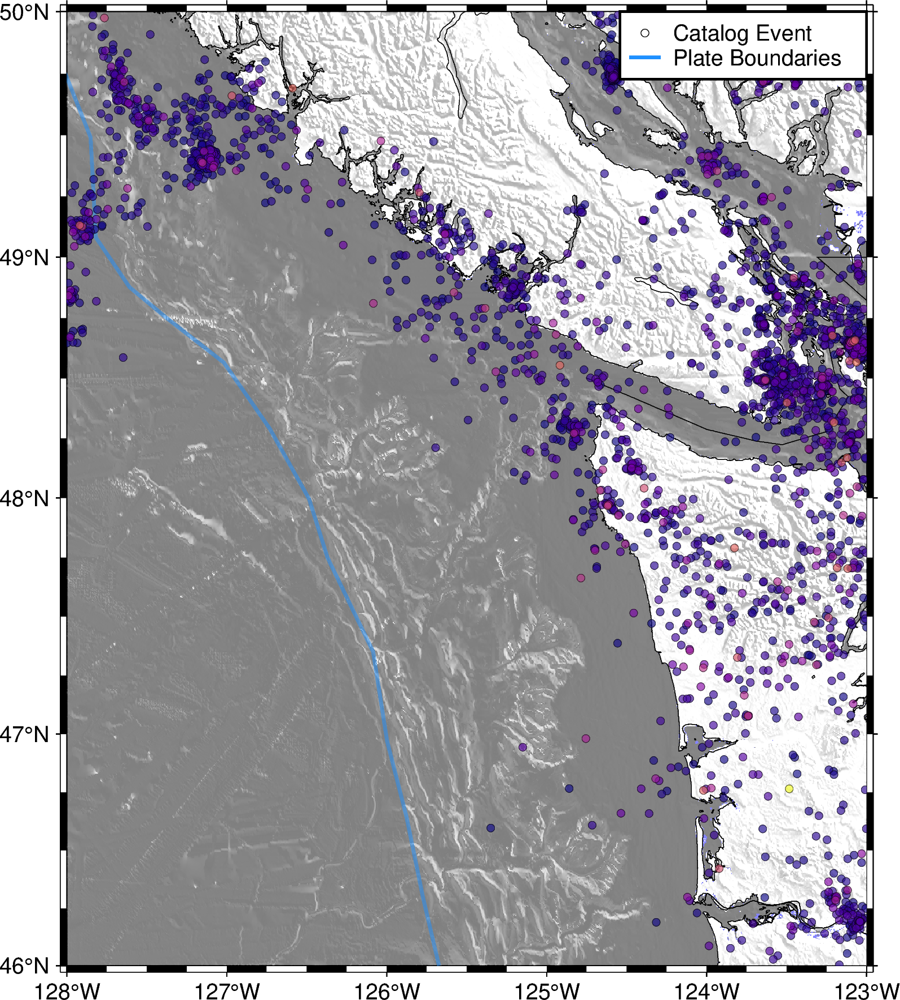

In [58]:
# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50
min_lon = -128
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(d)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
nass_log_min = _df['nass'].min()
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],
    cmap=True,
    pen="0.1p,black",
    transparency=35
)

# Plot a dummy object for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
    x=[120, +120],
    y=[-30, -30],
    pen="1.5p,dodgerblue1", label='Plate Boundaries'
)

# Position the text 1.5 cm from the top left corner
# fig.text(
#     x=min_lon + (max_lon - min_lon) * (1 / 14),  # Adjust x based on 1.5 cm from left
#     y=max_lat - (max_lat - min_lat) * (1 / 21),  # Adjust y based on 1.5 cm from top
#     text=title,
#     font="25p,Helvetica-Bold,black",
#     no_clip=True
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')

# Save the figure
fig.savefig("../data/datasets_all_regions/northern_wa_events_2010_2015_ver3_nass_no_relief_no_label.png")

# Display the figure
fig.show()

## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_2327881/3871826601.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_2327881/3871826601.py:44: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


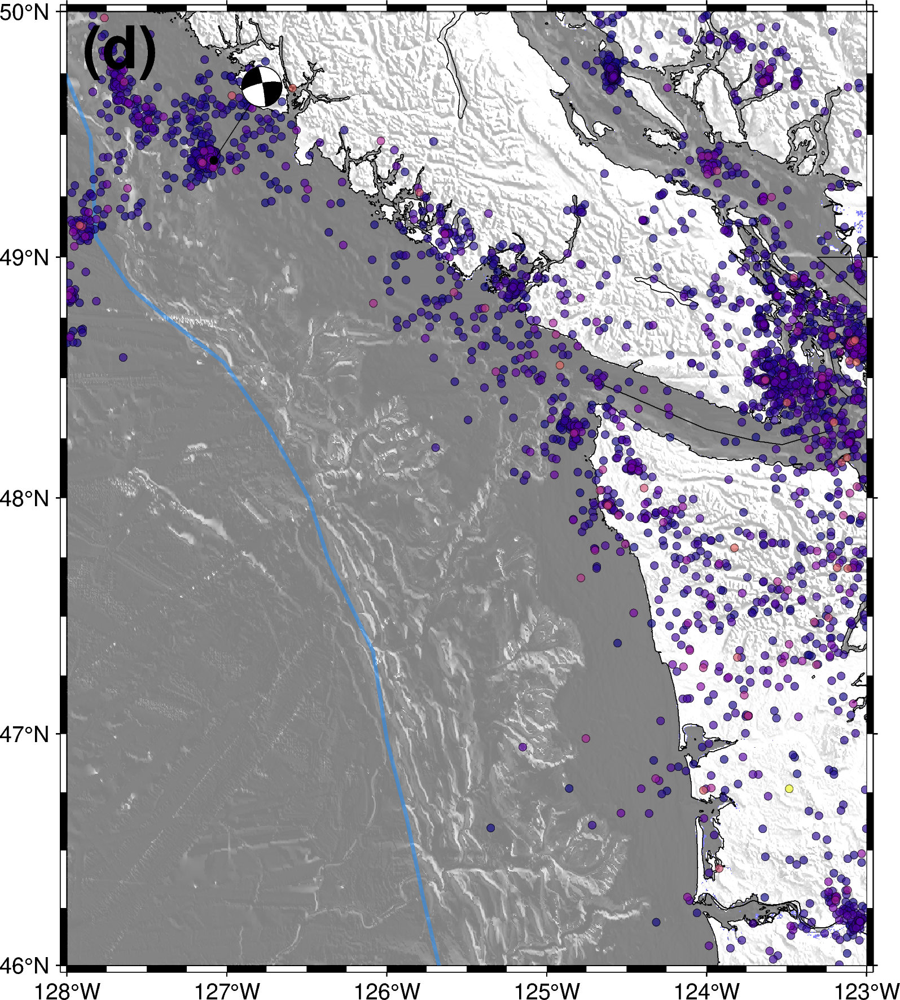

In [29]:
# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50
min_lon = -128
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(d)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
nass_log_min = _df['nass'].min()
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],
    cmap=True,
    pen="0.1p,black",
    transparency=35
)

# Plot a dummy object for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
    x=[120, +120],
    y=[-30, -30],
    pen="1.5p,dodgerblue1", label='Plate Boundaries'
)

# Position the text 1.5 cm from the top left corner
# Position the text 1.5 cm from the top left corner
fig.text(
    x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
    y=max_lat - (max_lat - min_lat) * (1 / 28),  # Adjust y based on 1.5 cm from top
    text=title,
    font="25p,Helvetica-Bold,black",
    no_clip=True
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )
focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.55c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,black+s0.12c")
# Add the legend to the plot
# fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')


# Save the figure
fig.savefig("../data/datasets_all_regions/northern_wa_events_2010_2015_ver3_nass_fo_4_no_legend.png")

# Display the figure
fig.show()

## Plot the colorbar

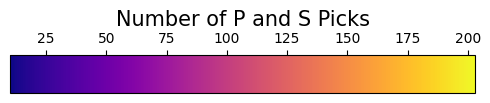

In [35]:
# Define the normalization range and colormap
min_nass = _df['nass'].min()  # Replace with the appropriate data source if needed
max_nass = _df['nass'].max()

norm = mcolors.Normalize(vmin=min_nass, vmax=max_nass)
cmap = cm.plasma  # Use the same colormap as in the previous plots

# Create a figure for the color bar
fig, ax = plt.subplots(figsize=(6, 1))  # Adjust the size as needed
fig.subplots_adjust(bottom=0.5)

# Create the color bar
cbar = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), cax=ax, orientation='horizontal')

# Set the color bar label
cbar.set_label('Number of P and S Picks', fontsize=15)

# Move the ticks and labels above the color bar
cbar.ax.xaxis.set_ticks_position('top')  # Move ticks to the top
cbar.ax.xaxis.set_label_position('top')  # Move the label to the top

# Save the color bar as a PNG
fig.savefig("../data/datasets_all_regions/colorbar.png", dpi=300, bbox_inches='tight')

# Display the color bar
plt.show()

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1854480/3147188189.py:61: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


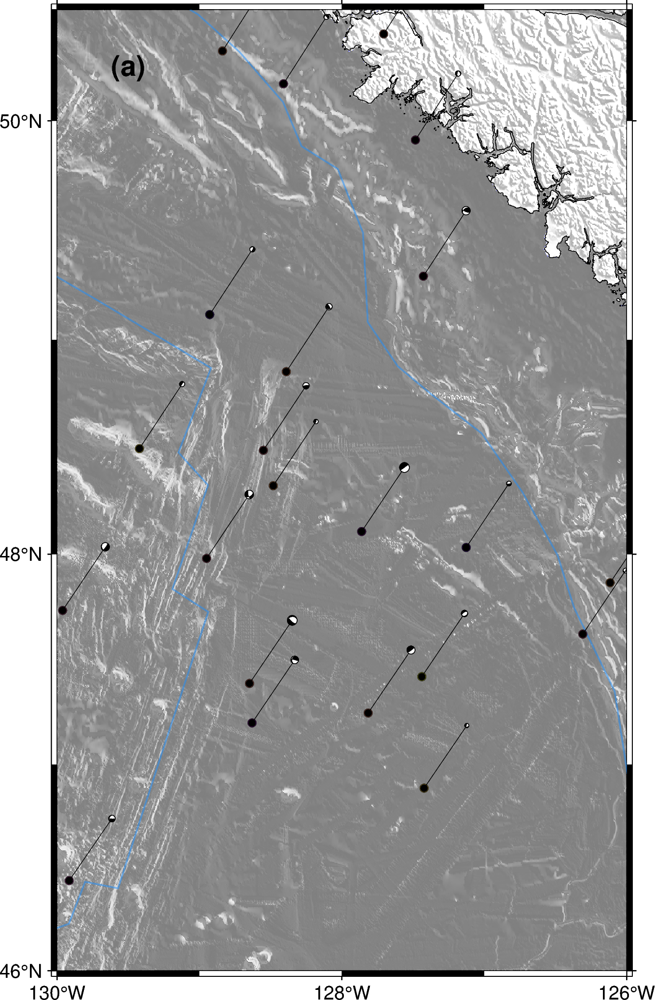

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1854480/3147188189.py:61: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


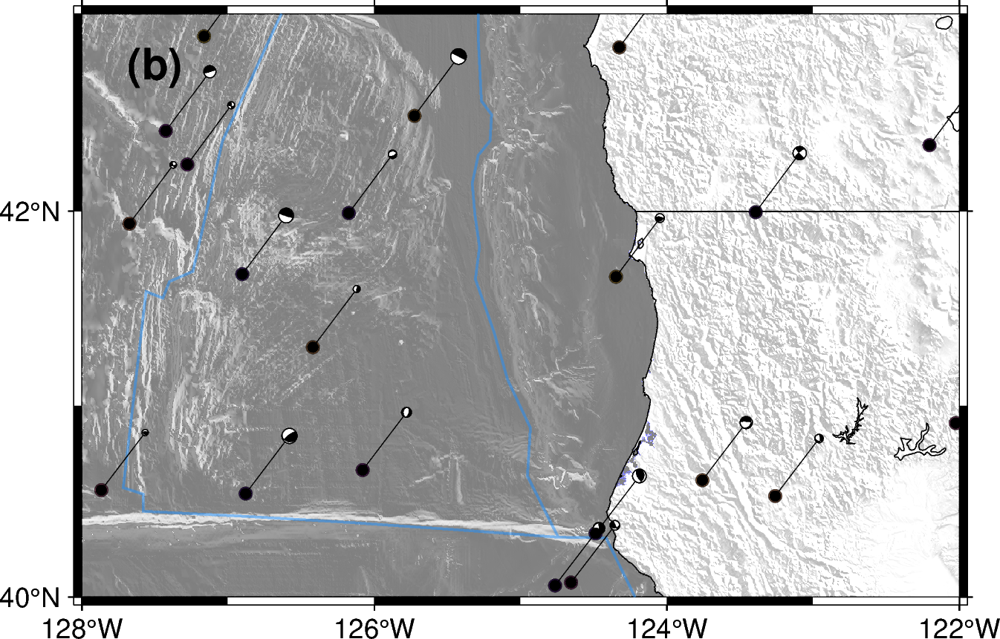

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1854480/3147188189.py:61: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


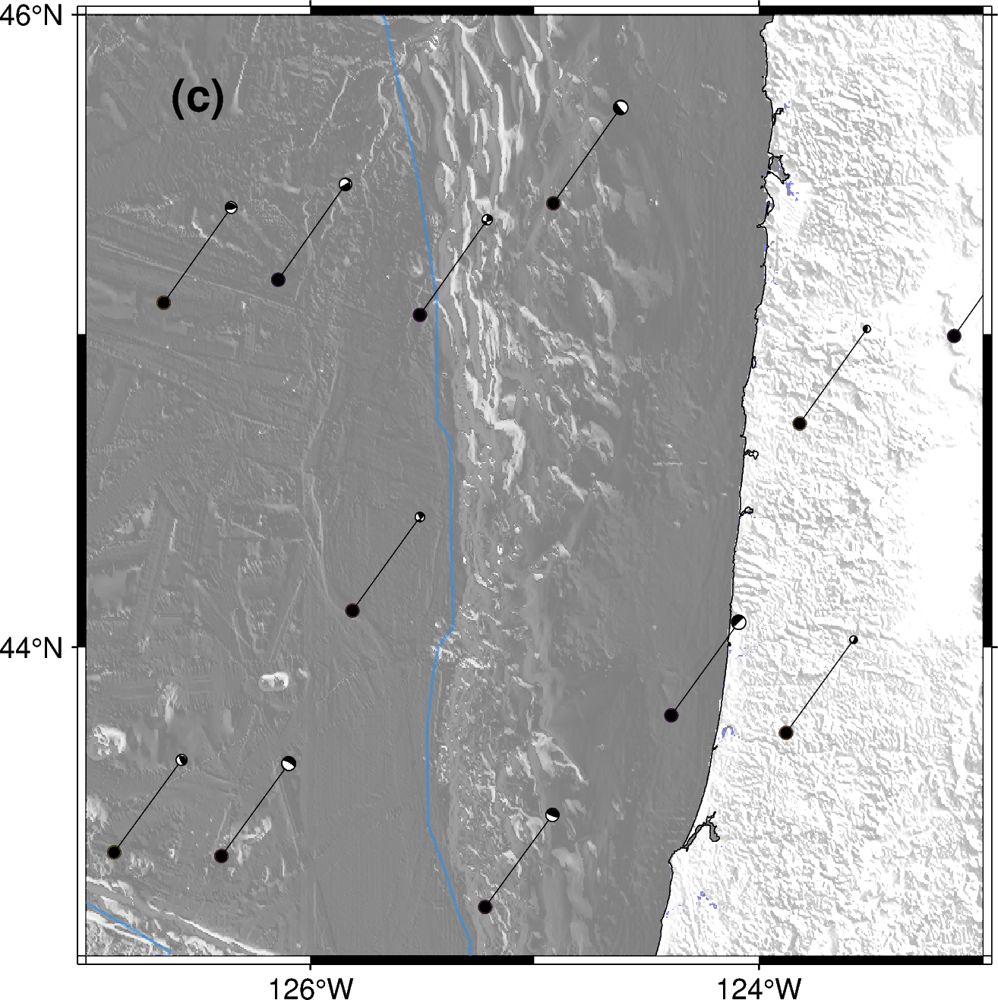

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1854480/3147188189.py:61: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


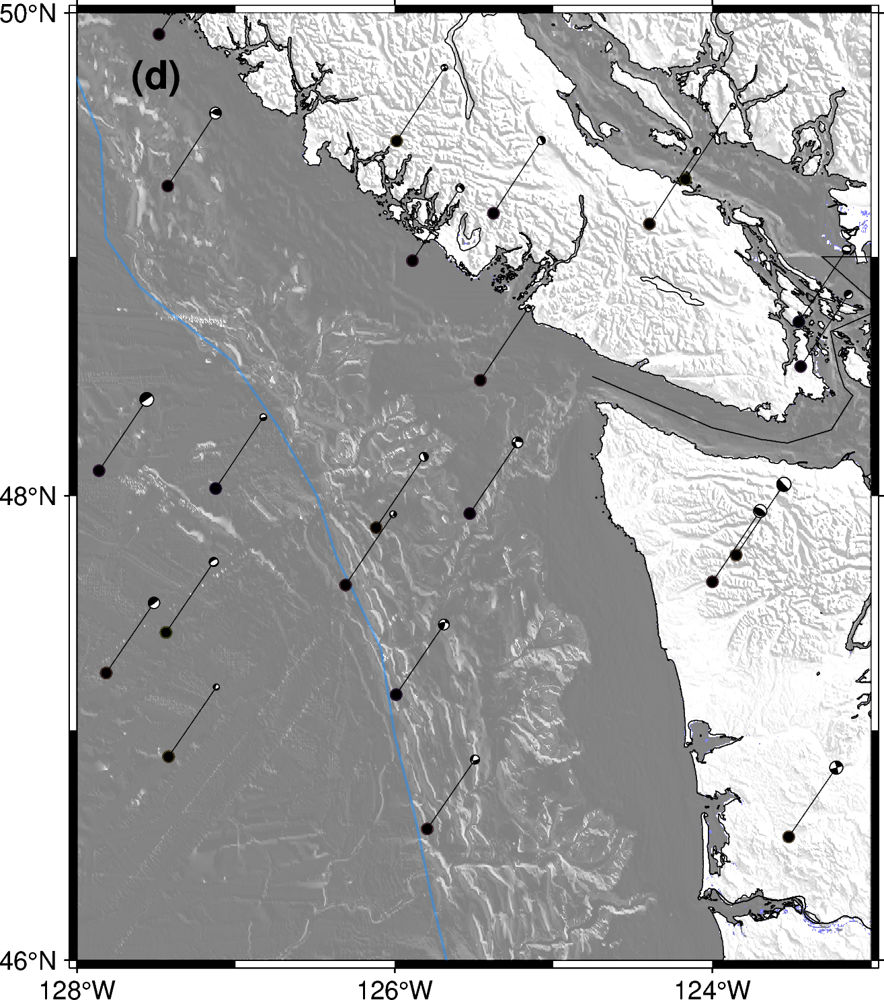

In [273]:
# Individual PyGMT Plotting Scripts with Uniform Styling

import pygmt
import pandas as pd
import numpy as np

# Define uniform styling parameters
marker_size = "0.15c"
marker_pen = "0.25p,black"
beachball_scale = "0.18c"
transparency = 30
border_pen = "0.75p,dodgerblue1"
plate_boundary_file = "PB2002_boundaries.dig"

# Sample data (replace with actual data)
df = pd.DataFrame({
    'lon': np.random.uniform(-130, -122, 100),
    'lat': np.random.uniform(39, 50.5, 100),
    'nass': np.random.uniform(1, 100, 100),
    'strike': np.random.uniform(0, 360, 100),
    'dip': np.random.uniform(0, 90, 100),
    'rake': np.random.uniform(-180, 180, 100),
    'mag': np.random.uniform(2.0, 5.0, 100),
    'depth': np.random.uniform(0, 50, 100)
})

# Define regions
regions = {
    "a": [-130, -126, 46, 50.5],
    "b": [-128, -122, 40, 43],
    "c": [-127, -123, 43, 46],
    "d": [-128, -123, 46, 50]
}

# Define projection
projection = "M10c"

for key, region in regions.items():
    # Initialize figure
    fig = pygmt.Figure()
    
    # Load grid data and shading
    grid = pygmt.datasets.load_earth_relief(resolution="15s", region=region)
    shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

    # Base map
    fig.basemap(region=region, projection=projection, frame=["a2f1", "WSen"])


    fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
    fig.coast(shorelines=True, borders=[1, 2], resolution="f")
    
    # Plate boundaries
    fig.plot(data=plate_boundary_file, pen=border_pen, transparency=50)

    # Color map for 'nass'
    nass_log_min, nass_log_max = df['nass'].min(), df['nass'].max()
    pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

    # Plot data points
    fig.plot(
        x=df['lon'],
        y=df['lat'],
        style=f"c{marker_size}",
        color=df['nass'],
        cmap=True,
        pen=marker_pen,
        transparency=transparency
    )

    # Plot focal mechanisms
    focal_mechanism = dict(
        strike=df.strike, dip=df.dip, rake=df.rake, magnitude=df.mag
    )
    offset_beachball = 0.3
    fig.meca(
        focal_mechanism,
        scale=beachball_scale,
        longitude=df.lon,
        latitude=df.lat,
        depth=df.depth,
        plot_latitude=df.lat + offset_beachball,
        plot_longitude=df.lon + offset_beachball,
        offset="0.2p,black+s0.12c"
    )

    # Add subplot label
    fig.text(
        x=region[0] + 0.5,
        y=region[3] - 0.25,
        text=f"({key})",
        font="14p,Helvetica-Bold,black",
        no_clip=True
    )

    # Save the individual figure
    fig.savefig(f"../data/plot_{key}.png")
    
    # Show the figure
    fig.show()


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1854480/653503480.py:25: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


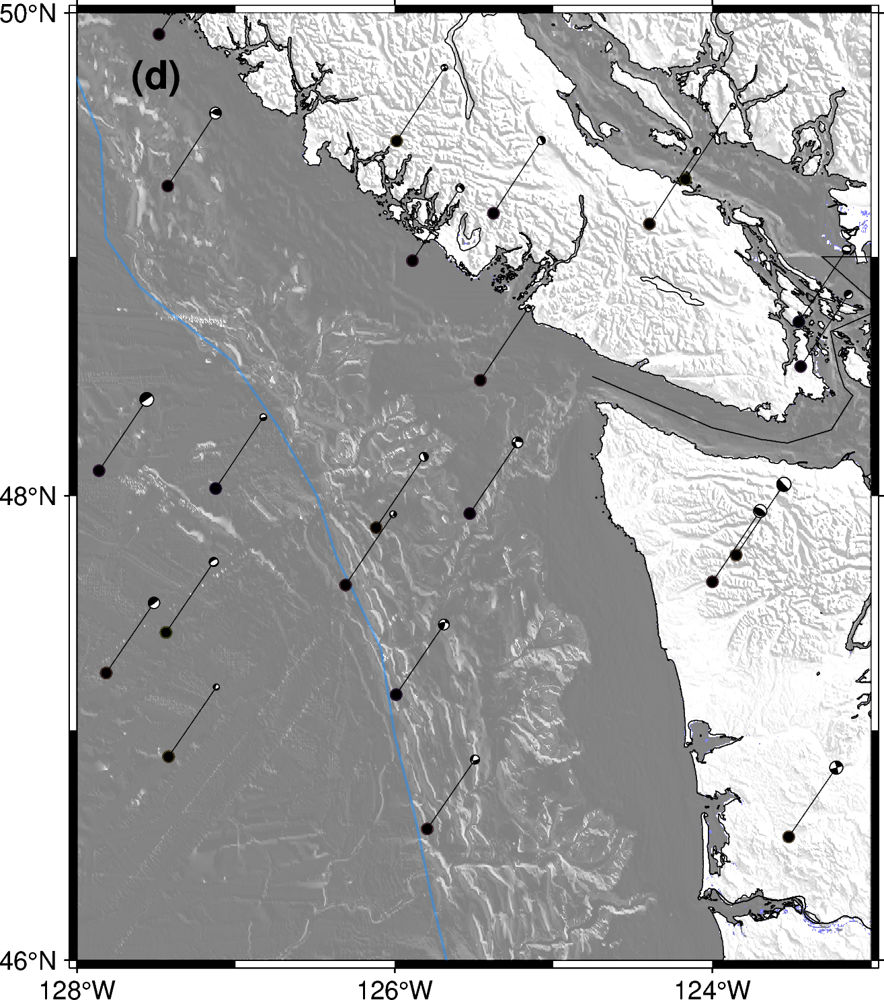

In [274]:
# Figure (d) - Northern WA
fig = pygmt.Figure()

# Define target region for (d)
region = [-128, -123, 46, 50]
projection = "M10c"

# Load grid data and shading
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=region)
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Base map with fixed frame size and font size
fig.basemap(region=region, projection=projection, frame=["a2f1", "WSen"])
fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(shorelines=True, borders=[1, 2], resolution="f")

# Plate boundaries
fig.plot(data="PB2002_boundaries.dig", pen="0.75p,dodgerblue1", transparency=50)

# Apply color map for 'nass'
nass_log_min, nass_log_max = df['nass'].min(), df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot data points
fig.plot(
    x=df['lon'],
    y=df['lat'],
    style="c0.15c",  # Fixed marker size
    color=df['nass'],
    cmap=True,
    pen="0.25p,black",
    transparency=30
)

# Plot focal mechanisms
focal_mechanism = dict(
    strike=df.strike, dip=df.dip, rake=df.rake, magnitude=df.mag
)
fig.meca(
    focal_mechanism,
    scale="0.18c",  # Uniform beachball size
    longitude=df.lon,
    latitude=df.lat,
    depth=df.depth,
    plot_latitude=df.lat + 0.3,
    plot_longitude=df.lon + 0.3,
    offset="0.2p,black+s0.12c"
)

# Add subplot label
fig.text(
    x=-127.5,
    y=49.75,
    text="(d)",
    font="14p,Helvetica-Bold,black",
    no_clip=True
)

# Save the individual figure
fig.savefig("../data/plot_d.png")

# Show the figure
fig.show()



RasterioIOError: ETOPO1_Bed_c_gmt4.grd: No such file or directory

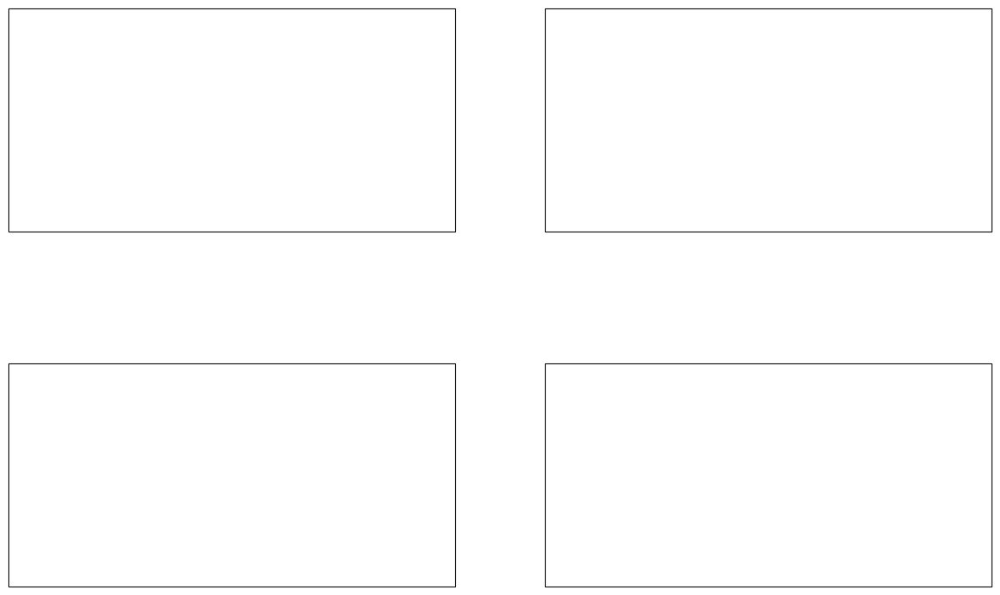

In [282]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import rasterio

# Define regions with extent (min_lon, max_lon, min_lat, max_lat)
regions = {
    "California": [-126, -113, 32, 43],
    "Japan": [128, 147, 30, 46],
    "Chile": [-80, -66, -56, -16],
    "Indonesia": [94, 141, -11, 6]
}

def load_topo_data(min_lon, max_lon, min_lat, max_lat, filepath="ETOPO1_Bed_c_gmt4.grd"):
    with rasterio.open(filepath) as src:
        bounds = src.bounds
        img = src.read(1)  # Elevation values
        lon = np.linspace(bounds.left, bounds.right, img.shape[1])
        lat = np.linspace(bounds.top, bounds.bottom, img.shape[0])

        # Crop to region using index slicing
        lon_idx = np.where((lon >= min_lon) & (lon <= max_lon))[0]
        lat_idx = np.where((lat <= max_lat) & (lat >= min_lat))[0]  # decreasing lat

        cropped_img = img[np.min(lat_idx):np.max(lat_idx)+1, np.min(lon_idx):np.max(lon_idx)+1]
        cropped_lon = lon[np.min(lon_idx):np.max(lon_idx)+1]
        cropped_lat = lat[np.min(lat_idx):np.max(lat_idx)+1]

        return {
            "lon": cropped_lon,
            "lat": cropped_lat,
            "z": cropped_img
        }

# Plotting
fig, axs = plt.subplots(2, 2, figsize=(15, 10), subplot_kw={'projection': ccrs.PlateCarree()})
axs = axs.flatten()

for ax, (label, region) in zip(axs, regions.items()):
    min_lon, max_lon, min_lat, max_lat = region
    topo = load_topo_data(min_lon, max_lon, min_lat, max_lat)

    ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, zorder=0, facecolor="lightgray")
    ax.add_feature(cfeature.OCEAN, zorder=0, facecolor="lightblue")
    ax.coastlines(resolution='10m')

    lon2d, lat2d = np.meshgrid(topo["lon"], topo["lat"])
    contour = ax.contourf(
        lon2d, lat2d, topo["z"],
        60,
        transform=ccrs.PlateCarree(),
        cmap="terrain",
        alpha=0.6,
        zorder=1
    )

    ax.set_title(label)

# Colorbar
cbar = fig.colorbar(contour, ax=axs, orientation='horizontal', shrink=0.7, pad=0.05)
cbar.set_label("Topography (m)")

plt.tight_layout()
plt.show()


TypeError: Dimensions of C (0, 3600) should be one smaller than X(3601) and Y(0) while using shading='flat' see help(pcolormesh)

/home/jupyter_share/miniconda3/envs/seismo/lib/python3.9/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/50m_physical/ne_50m_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/home/jupyter_share/miniconda3/envs/seismo/lib/python3.9/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/10m_physical/ne_10m_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


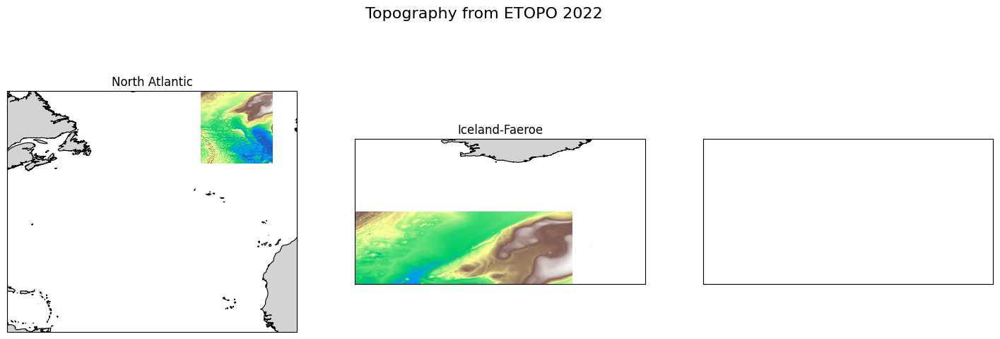

In [287]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Load dataset
ds = xr.open_dataset("ETOPO_2022_v1_15s_N60W030_bed.nc")

# Extract elevation and coordinates
elevation = ds['z']
lat = ds['lat']
lon = ds['lon']

# Define regions as (min_lon, max_lon, min_lat, max_lat)
regions = {
    "North Atlantic": (-70, -10, 10, 60),
    "Iceland-Faeroe": (-30, -10, 55, 65),
    "Greenland Sea": (-40, 0, 60, 80)
}

# Create subplot layout
fig, axs = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.PlateCarree()})
fig.suptitle("Topography from ETOPO 2022", fontsize=16)

for ax, (label, (min_lon, max_lon, min_lat, max_lat)) in zip(axs, regions.items()):
    # Choose correct latitude slice direction based on data order
    if lat[0] > lat[-1]:  # descending
        lat_slice = slice(max_lat, min_lat)
    else:  # ascending
        lat_slice = slice(min_lat, max_lat)

    # Longitude is usually ascending
    lon_slice = slice(min_lon, max_lon)

    # Subset elevation
    subset = elevation.sel(lat=lat_slice, lon=lon_slice)

    # Ensure dimensions match pcolormesh requirement
    lon2d, lat2d = np.meshgrid(subset['lon'], subset['lat'])

    im = ax.pcolormesh(
        lon2d, lat2d, subset,
        cmap='terrain', shading='auto', transform=ccrs.PlateCarree()
    )

    ax.set_title(label)
    ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, facecolor="lightgray", zorder=1)
    ax.coastlines(resolution='10m', linewidth=0.8)

# Add a single colorbar
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), orientation='horizontal', pad=0.05)
cbar.set_label("Elevation (m)")

plt.tight_layout()
plt.show()


TypeError: Dimensions of C (0, 3600) should be one smaller than X(3601) and Y(0) while using shading='flat' see help(pcolormesh)

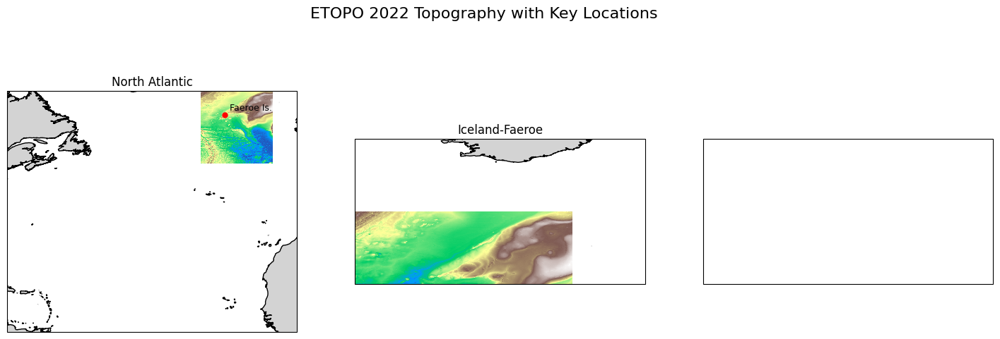

In [288]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np

# Load dataset
ds = xr.open_dataset("ETOPO_2022_v1_15s_N60W030_bed.nc")
elevation = ds['z']
lat = ds['lat']
lon = ds['lon']

# Define regions as (min_lon, max_lon, min_lat, max_lat)
regions = {
    "North Atlantic": (-70, -10, 10, 60),
    "Iceland-Faeroe": (-30, -10, 55, 65),
    "Greenland Sea": (-40, 0, 60, 80)
}

# Example markers: (longitude, latitude, label)
markers = [
    (-30.0, 63.0, "Iceland"),
    (-20.0, 70.0, "Jan Mayen"),
    (-45.0, 60.0, "SE Greenland"),
    (-25.0, 55.0, "Faeroe Is.")
]

# Create figure
fig, axs = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.PlateCarree()})
fig.suptitle("ETOPO 2022 Topography with Key Locations", fontsize=16)

# Plot each region
for ax, (label, (min_lon, max_lon, min_lat, max_lat)) in zip(axs, regions.items()):
    # Handle latitude direction
    if lat[0] > lat[-1]:  # descending
        lat_slice = slice(max_lat, min_lat)
    else:  # ascending
        lat_slice = slice(min_lat, max_lat)
    lon_slice = slice(min_lon, max_lon)

    # Subset elevation
    subset = elevation.sel(lat=lat_slice, lon=lon_slice)

    # 2D grids for pcolormesh
    lon2d, lat2d = np.meshgrid(subset['lon'], subset['lat'])

    # Plot topography
    im = ax.pcolormesh(
        lon2d, lat2d, subset,
        cmap='terrain', shading='auto', transform=ccrs.PlateCarree()
    )

    # Add map features
    ax.set_title(label)
    ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())
    ax.coastlines(resolution='10m')
    ax.add_feature(cfeature.LAND, facecolor='lightgray', zorder=1)

    # Plot markers
    for m_lon, m_lat, m_label in markers:
        if min_lon < m_lon < max_lon and min_lat < m_lat < max_lat:
            ax.plot(m_lon, m_lat, 'ro', transform=ccrs.PlateCarree(), markersize=5, zorder=3)
            ax.text(m_lon + 1, m_lat + 1, m_label, fontsize=9, transform=ccrs.PlateCarree())

# Colorbar
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), orientation='horizontal', pad=0.05)
cbar.set_label("Elevation (m)")

plt.tight_layout()
plt.show()
